In [1]:
#pip install reportlab
import json
import glob
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import itertools
from matplotlib.backends.backend_pdf import PdfPages

In [2]:
with open('dataset.json', 'r') as file:
    data = json.load(file)

print(data)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [3]:
len(data)

16455

In [4]:
# extract images of one restaurant
one_restaurant_info=data[0]['more_details']['full_images']
one_restaurant_images=[i['image_id'] for i in one_restaurant_info]
one_restaurant_images

['2088757', '2182000', '4151606', '4151588', '2224983']

In [5]:
# do this for all restaurants

res_image_dic={}
for res in data:
    res_id=res['identifier']
    one_restaurant_info=res['more_details']['full_images']
    one_restaurant_images=[i['image_id'] for i in one_restaurant_info]
    res_image_dic[res_id]=one_restaurant_images

In [6]:
# check if restaurant ids are unique
len(list(res_image_dic.keys()))== len(set(res_image_dic.keys()))

True

In [7]:
# list of all restaurant images
nested_list=list(res_image_dic.values())
image_names = list(itertools.chain(*nested_list))
#image_names

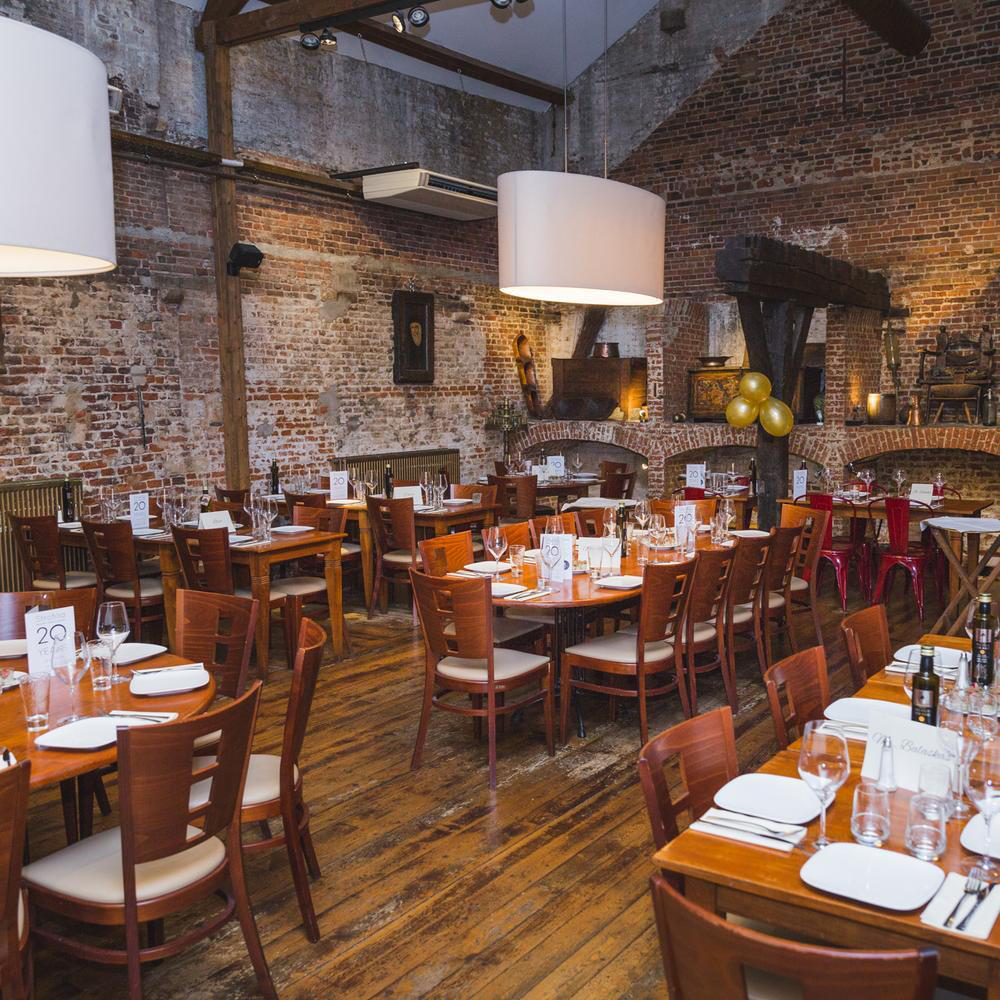

In [8]:
# test reading an image
folder_path = 'images'
image_path=folder_path + '/' + '4151606' + '.jpg'
img=Image.open(image_path)
img

In [9]:
# reading all images in a restaurant setting 
all_images={}
folder_path = 'images'
target_size = (256, 256) # need to resize because some images do not have the same shap

iteration=0 # read only 100 images for now
for name in image_names:
    iteration+=1
    file_name=name + '.jpg'
    image_path = folder_path + '/' + file_name
    if iteration <=500:
        try:
            with Image.open(image_path) as img:
                img = img.resize(target_size)
                image_array = np.array(img)

                all_images[name]=image_array
            #print(name)
        except:
            print(f"Error opening file '{file_name}', skipping...")
            continue

Error opening file '4215425.jpg', skipping...


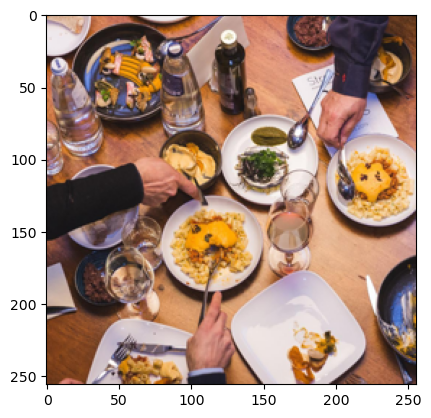

In [10]:
# plot one image based on id
plt.imshow(all_images['2182000'], cmap='gray')
plt.show()

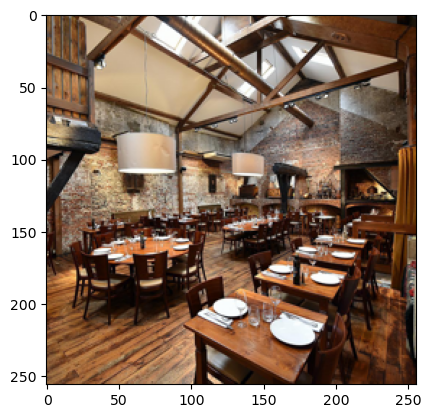

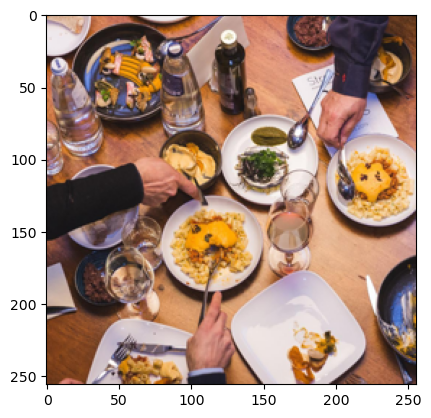

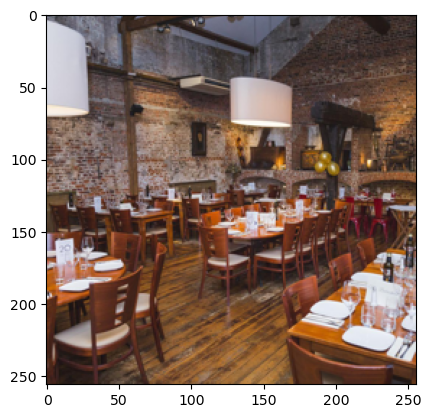

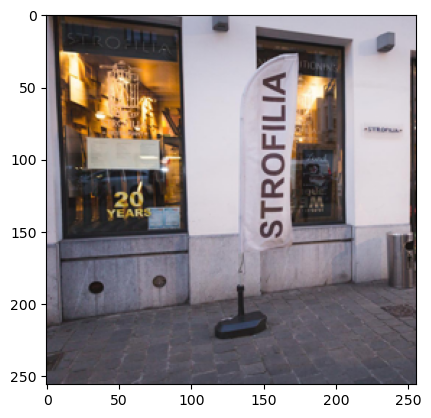

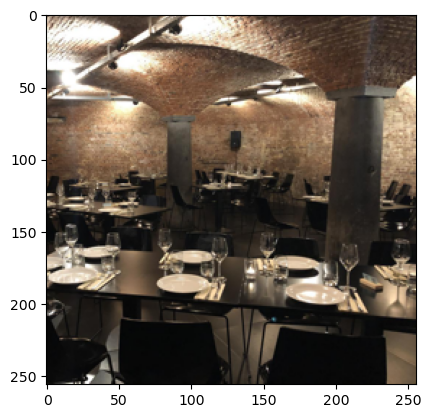

...

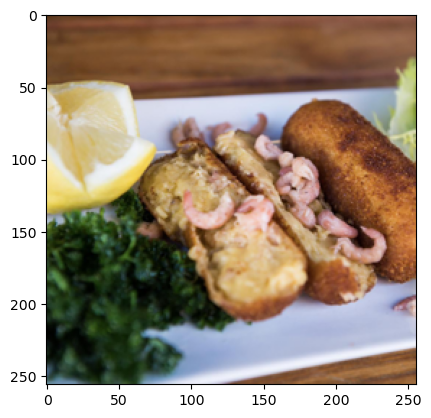

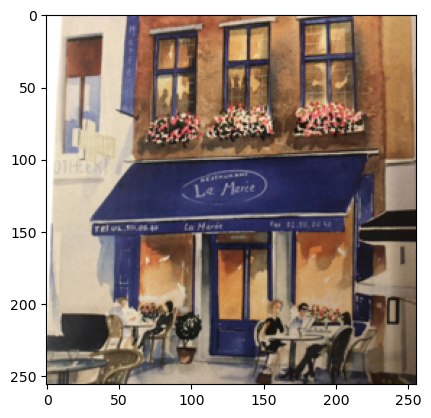

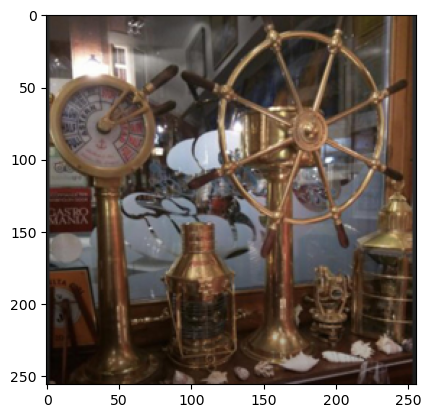

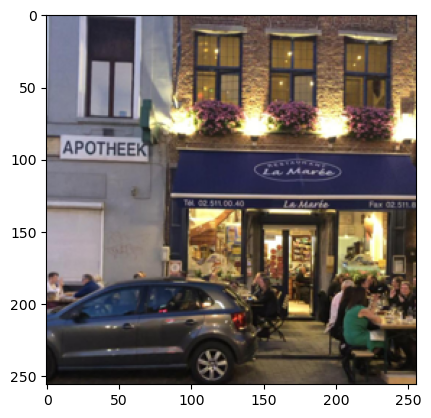

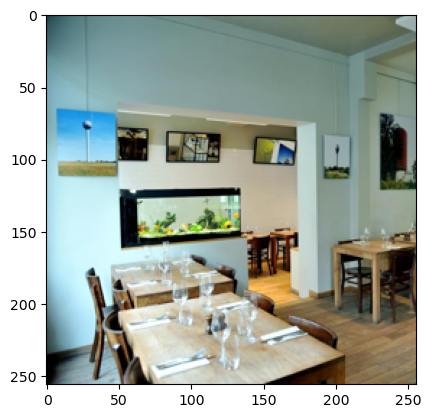

In [11]:
# add manual label
selected_ids=(list(all_images.keys()))
label_ids=selected_ids[:20] # should change to random select just in case there is corr
no_label_ids=selected_ids[20:]

train_image_list=[]
for i in label_ids: # show images in order to label them 
    plt.imshow(all_images[i], cmap='gray')
    plt.show()
    if all_images[i].shape==(256, 256, 3):
        train_image_list.append(all_images[i])
    #print(all_images[i].shape) 

In [12]:
test_image_list=[]
for i in no_label_ids:
    if all_images[i].shape==(256, 256, 3):
        test_image_list.append(all_images[i])
   # print(all_images[i].shape) 

In [13]:
# use 1 for food, 0 for interiror
label_ids = [0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0]
len(label_ids)

20

In [14]:
sum(label_ids) # there is a slight imbalance

8

In [15]:
train=np.array(train_image_list)
train.shape

(20, 256, 256, 3)

In [16]:
len(test_image_list)

478

In [17]:
test=np.array(test_image_list)
test.shape

(478, 256, 256, 3)

In [18]:
import numpy as np
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.applications import VGG16

# Load the pre-trained model
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Freeze pre-trained layers (compare with no freezing)
for layer in base_model.layers:
    layer.trainable = False

# Define your own classification layers
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

2023-04-16 07:13:19.168365: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-16 07:13:28.799655: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [19]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 8, 8, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dense (Dense)               (None, 128)               4194432   
                                                                 
 dense_1 (Dense)             (None, 1)                 129       
                                                                 
Total params: 18,909,249
Trainable params: 4,194,561
Non-trainable params: 14,714,688
_________________________________________________________________


In [20]:
# Load your own training and test data (new result if freeze previous layers)
X_train = train[:10]
y_train = np.array(label_ids[:10])
X_test = train[10:]
y_test = np.array(label_ids[10:])

# Train the model
model.fit(X_train, y_train, epochs=10, batch_size=32, 
          validation_data=(X_test, y_test))

# Evaluate the model on test set
score = model.evaluate(X_test, y_test)
print('Test accuracy:', score[1])

Epoch 1/10
1/1 [==============================] - 8s 8s/step - loss: 5.6546 - accuracy: 0.2000 - val_loss: 5.4161e-07 - val_accuracy: 1.0000
Epoch 2/10
1/1 [==============================] - 7s 7s/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 3.5166e-11 - val_accuracy: 1.0000
Epoch 3/10
1/1 [==============================] - 6s 6s/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 2.3555e-15 - val_accuracy: 1.0000
Epoch 4/10
1/1 [==============================] - 6s 6s/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 7.5355e-19 - val_accuracy: 1.0000
Epoch 5/10
1/1 [==============================] - 5s 5s/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 3.5256e-21 - val_accuracy: 1.0000
Epoch 6/10
1/1 [==============================] - 5s 5s/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 4.4774e-22 - val_accuracy: 1.0000
Epoch 7/10
1/1 [==============================] - 5s 5s/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 9.5125e-23 - val_accura

In [21]:
#pip install modAL

In [22]:
# use the trained model for active learning
from sklearn.metrics import accuracy_score
from modAL.models import ActiveLearner
from modAL.uncertainty import uncertainty_sampling

learner = ActiveLearner(
    estimator=model,
    query_strategy=uncertainty_sampling,
    X_training=X_train, y_training=y_train
) # does not work immediately, write own codes

1/1 [==============================] - 2s 2s/step - loss: 0.0000e+00 - accuracy: 1.0000


In [23]:
predict_x=model.predict(test) 
#classes_x=np.argmax(predict_x,axis=1)

15/15 [==============================] - 114s 8s/step


In [24]:
y_pred_prob=predict_x.copy()

In [25]:
# calculate the entropy of each prediction
#entropy = -np.sum(y_pred_prob_smooth * np.log2(y_pred_prob_smooth) + (1 - y_pred_prob_smooth) * np.log2(1 - y_pred_prob_smooth), axis=1)
entropy = -np.sum(y_pred_prob * np.log2(y_pred_prob) + (1 - y_pred_prob) * np.log2(1 - y_pred_prob), axis=1)

/var/folders/ps/310fvxcx6y55_xvdkg77780h0000gn/T/ipykernel_18710/19492232.py:3: RuntimeWarning: divide by zero encountered in log2
  entropy = -np.sum(y_pred_prob * np.log2(y_pred_prob) + (1 - y_pred_prob) * np.log2(1 - y_pred_prob), axis=1)
/var/folders/ps/310fvxcx6y55_xvdkg77780h0000gn/T/ipykernel_18710/19492232.py:3: RuntimeWarning: invalid value encountered in multiply
  entropy = -np.sum(y_pred_prob * np.log2(y_pred_prob) + (1 - y_pred_prob) * np.log2(1 - y_pred_prob), axis=1)


In [26]:
# replace all NaN values with 0
entropy = np.nan_to_num(entropy, nan=0)


In [27]:
# sort the predictions by their entropy in descending order
sorted_indices = np.argsort(entropy)[::-1]

# select the top k instances with the highest entropy
k = 20
most_uncertain_indices = sorted_indices[:k]


In [28]:
most_uncertain_indices

array([204, 261,  53, 233,  72, 447, 382,  46, 474, 429, 450, 169, 158,
       150, 151, 152, 153, 173, 154, 172])

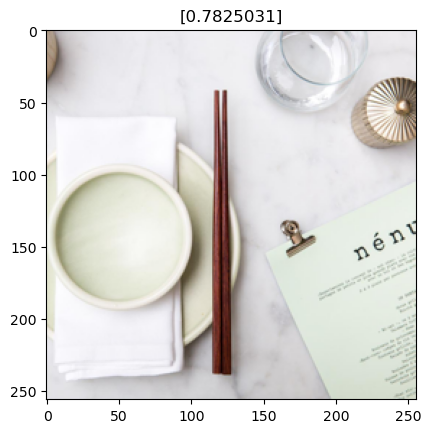

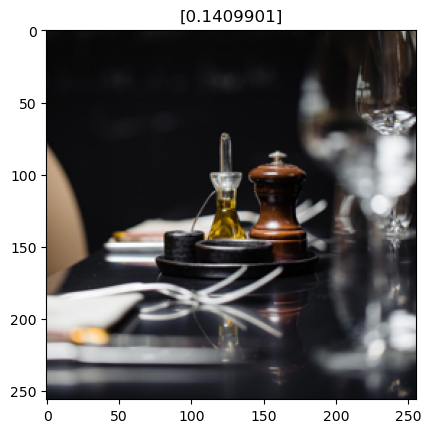

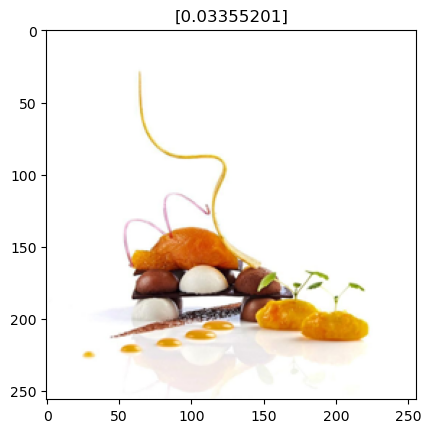

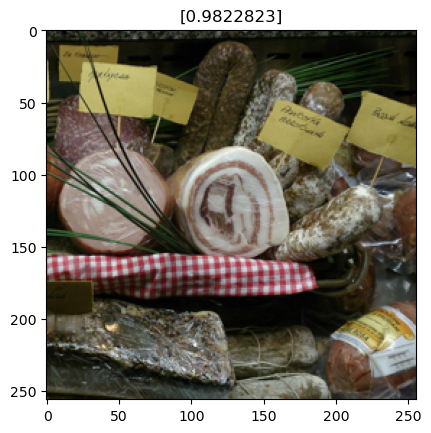

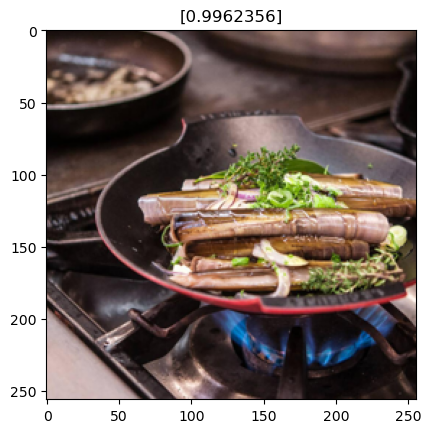

...

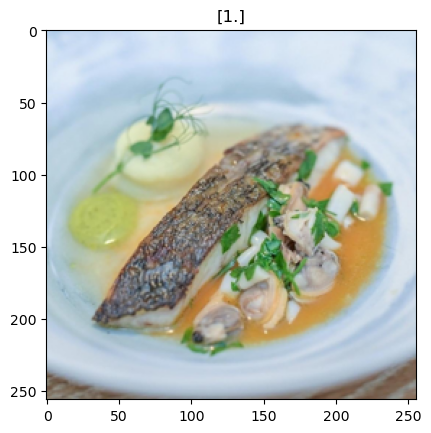

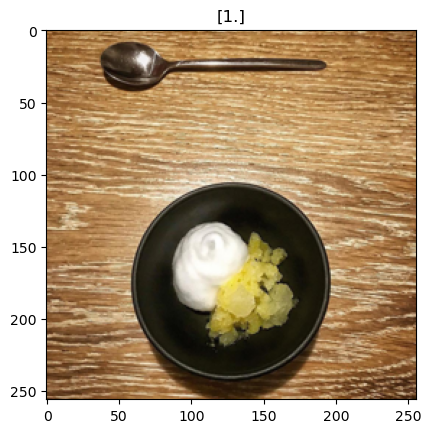

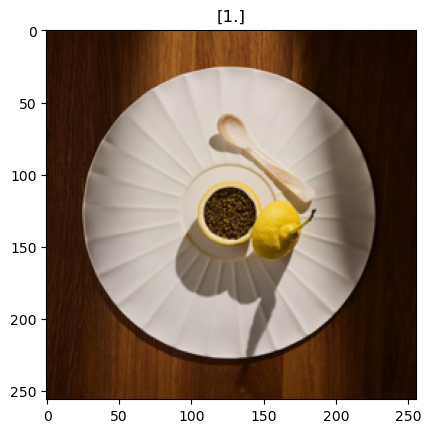

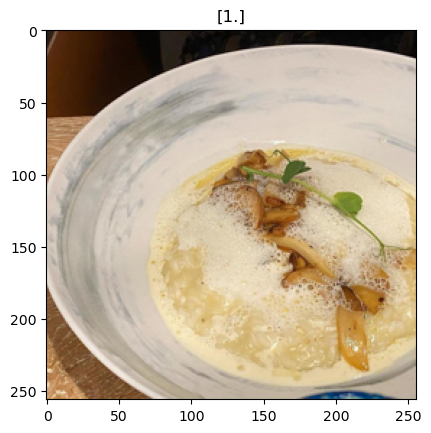

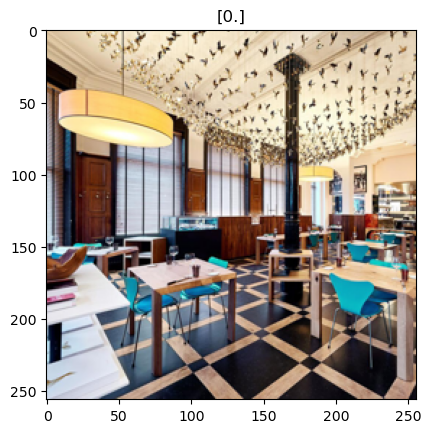

In [34]:
test_selected=[]
for i in most_uncertain_indices:
    plt.imshow(test[i], cmap='gray')
    plt.title(str(y_pred_prob[i]))
    plt.show()
    test_selected.append(test[i])

In [35]:
#new_index=[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
#this will change next time when you run the model,
# so better store the most uncertain indeces and the new index 

most_uncertain_indices=[204, 261,  53, 233,  72, 447, 382,  46, 474, 429, 450, 169, 158,
       150, 151, 152, 153, 173, 154, 172]

new_index = [0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1,1,1,0]
len(new_index)

20

In [36]:
train_image_list_new= train_image_list+test_selected 
train_label_new = label_ids+new_index 

In [37]:
# Load your own training and test data (new result if freeze previous layers)
# Train new model with labels from active learning
X_train = np.array(train_image_list_new)
y_train = np.array(train_label_new)
X_test = train[10:]
y_test = np.array(label_ids[10:])

# Train the model
model.fit(X_train, y_train, epochs=10, batch_size=32, 
          validation_data=(X_test, y_test))

# Evaluate the model on test set
score = model.evaluate(X_test, y_test)
print('Test accuracy:', score[1])

Epoch 1/10
2/2 [==============================] - 10s 3s/step - loss: 2.3864 - accuracy: 0.8250 - val_loss: 3.3762e-28 - val_accuracy: 1.0000
Epoch 2/10
2/2 [==============================] - 9s 3s/step - loss: 4.5796e-14 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 3/10
2/2 [==============================] - 9s 3s/step - loss: 2.6273e-13 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 4/10
2/2 [==============================] - 9s 3s/step - loss: 2.2113e-12 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 5/10
2/2 [==============================] - 10s 3s/step - loss: 5.4575e-11 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 6/10
2/2 [==============================] - 10s 4s/step - loss: 1.1648e-09 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 7/10
2/2 [==============================] - 10s 4s/step - loss: 1.0155e-08 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_ac

In [38]:
# look at the test images without labels, check if predicted correctly
# result improved after active learning (misclassify one image less)
new_images = test[:40]

In [39]:
# Predict new images with the model
model_predictions=model.predict(new_images)
# set the threshold
threshold = 0.5
# convert predicted probabilities to labels 0 and 1
predicted_labels = (model_predictions > threshold).astype(int)
# print the predicted labels

2/2 [==============================] - 9s 2s/step


In [40]:
label_dict={0: 'exterior', 1: 'food'}

image 0 label:food


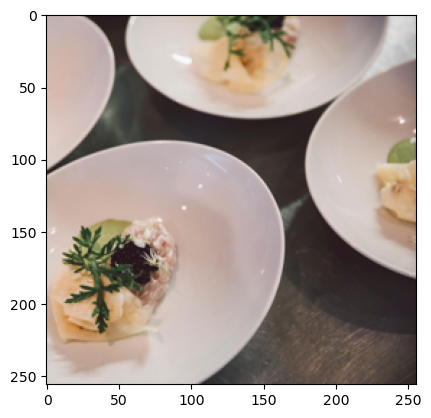

image 1 label:food


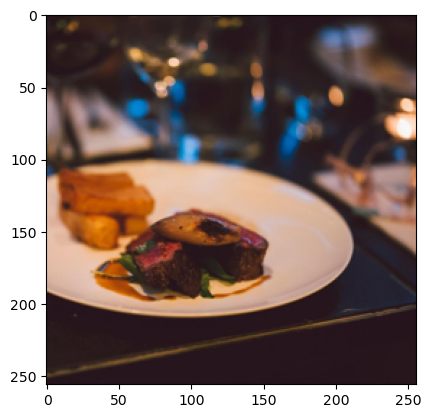

image 2 label:exterior


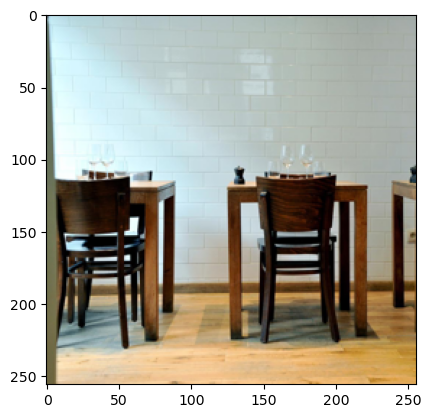

image 3 label:exterior


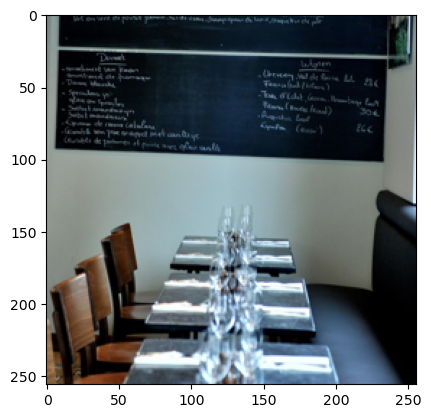

image 4 label:exterior


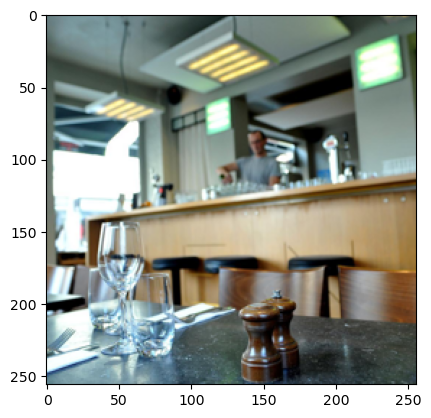

image 5 label:exterior


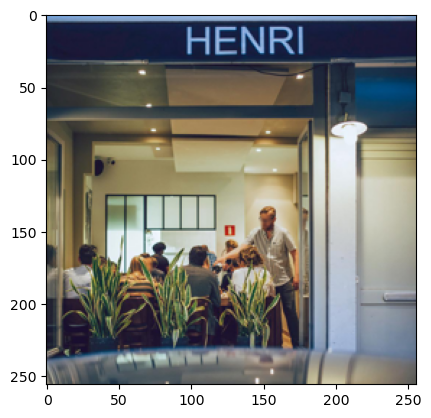

image 6 label:food


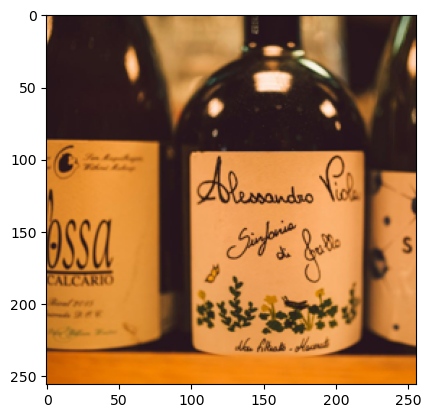

image 7 label:exterior


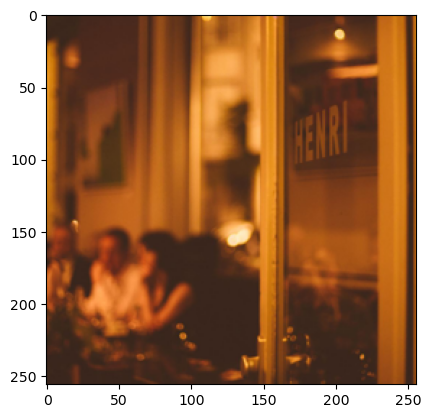

image 8 label:exterior


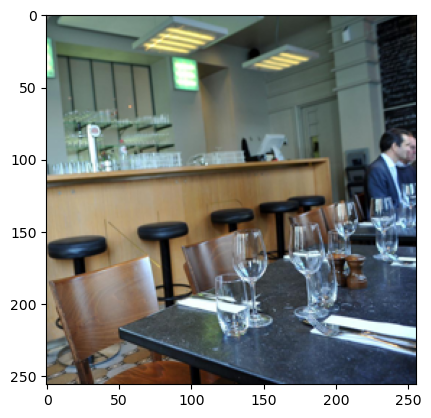

image 9 label:food


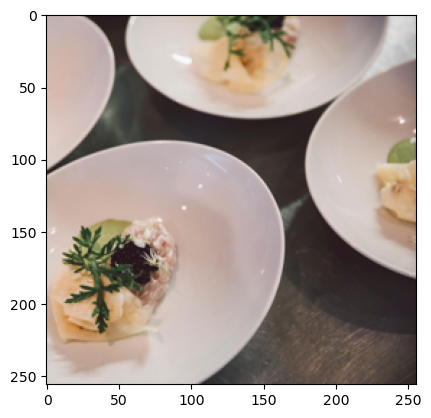

image 10 label:exterior


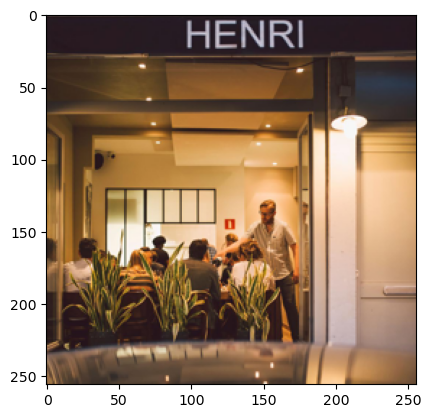

image 11 label:exterior


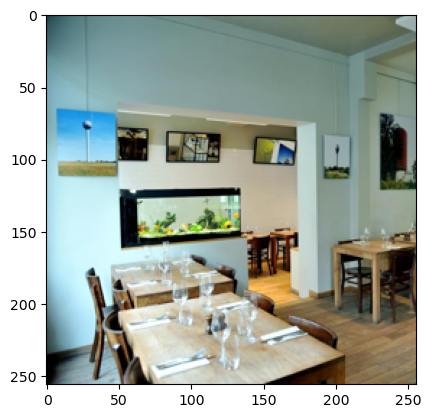

image 12 label:exterior


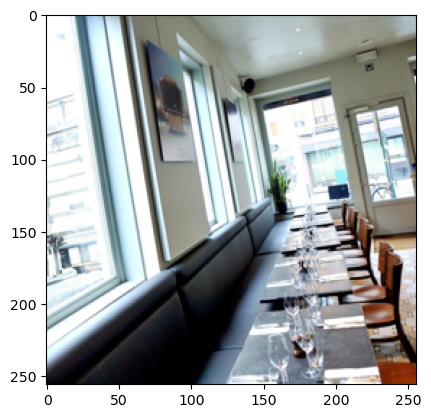

image 13 label:food


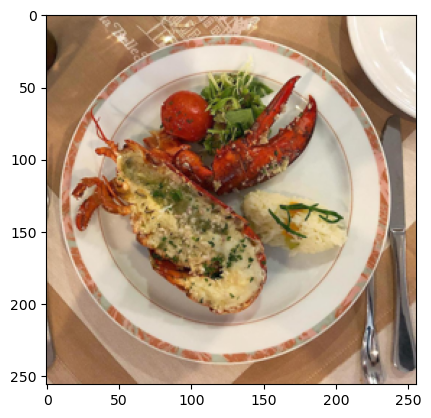

image 14 label:food


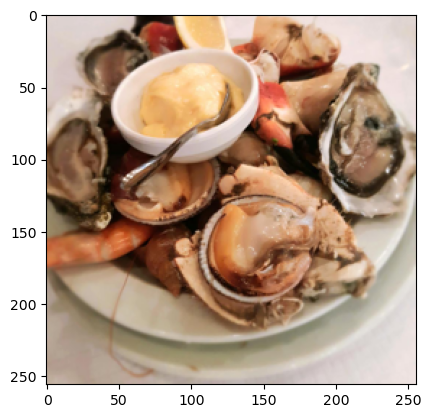

image 15 label:food


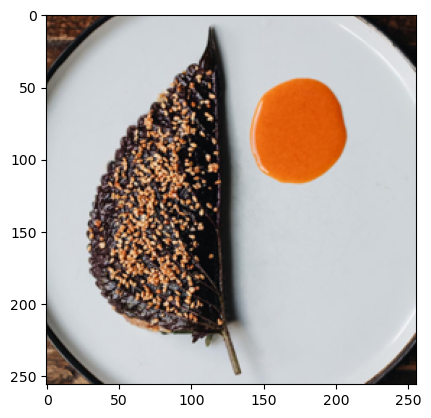

image 16 label:food


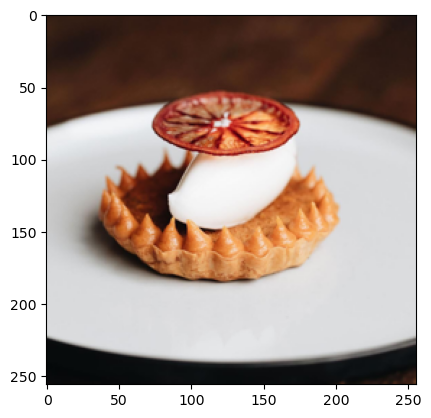

image 17 label:food


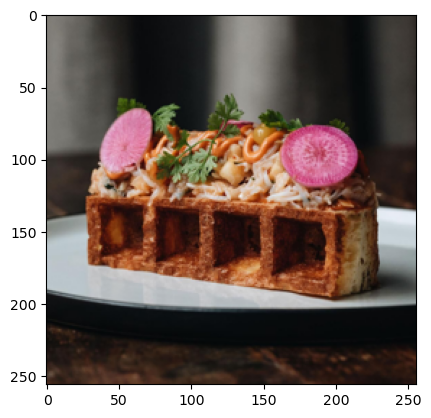

image 18 label:food


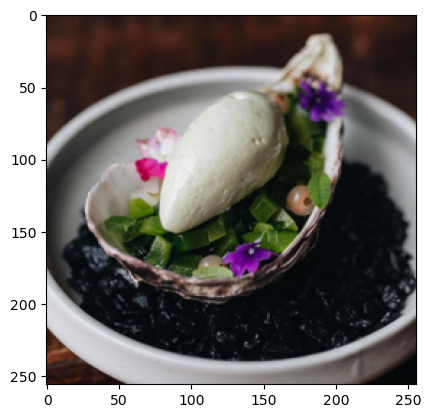

image 19 label:food


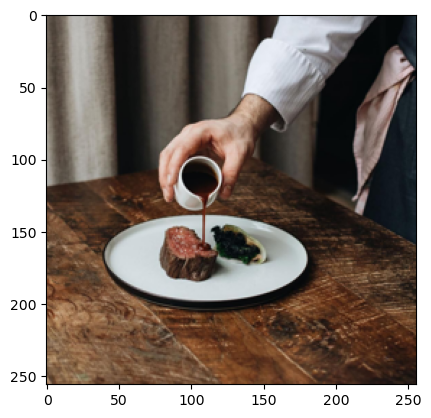

image 20 label:food


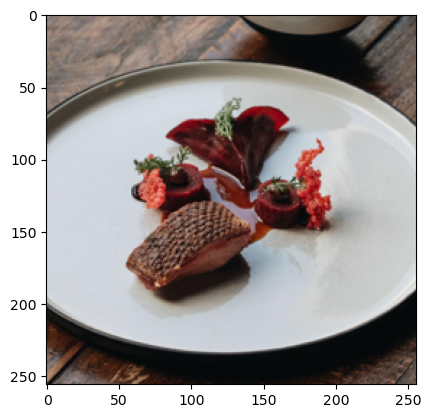

image 21 label:food


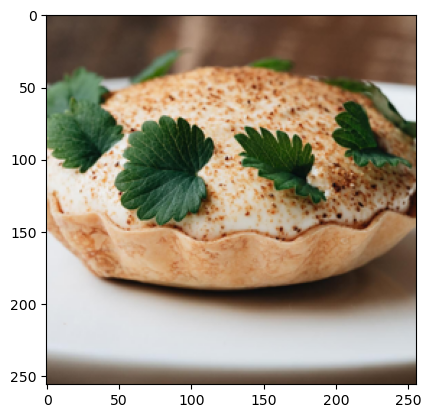

image 22 label:food


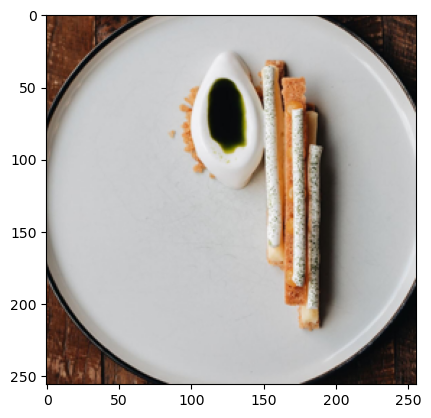

image 23 label:food


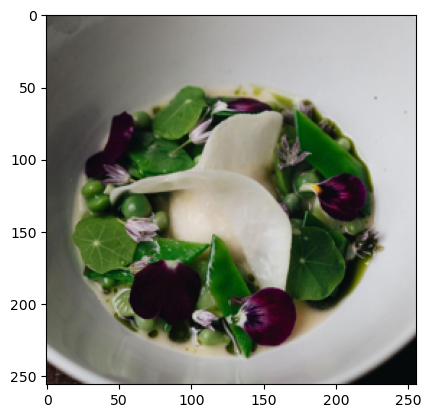

image 24 label:exterior


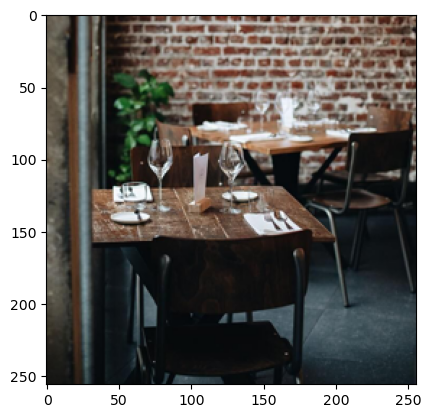

image 25 label:food


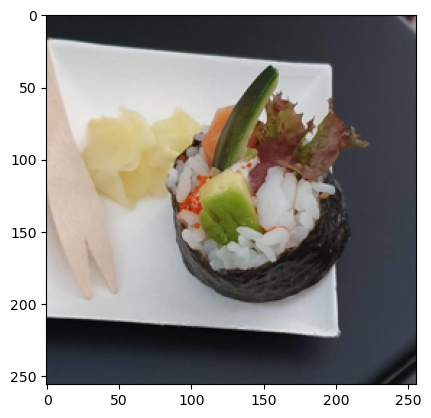

image 26 label:food


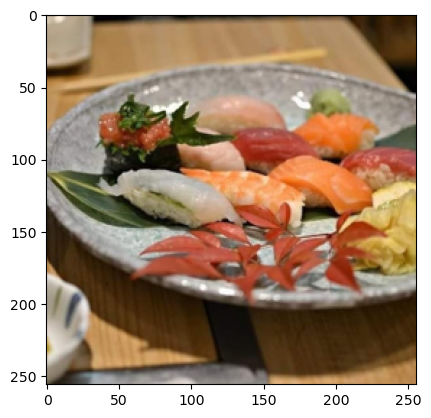

image 27 label:food


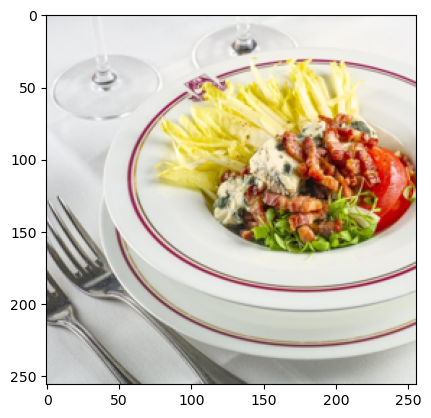

image 28 label:food


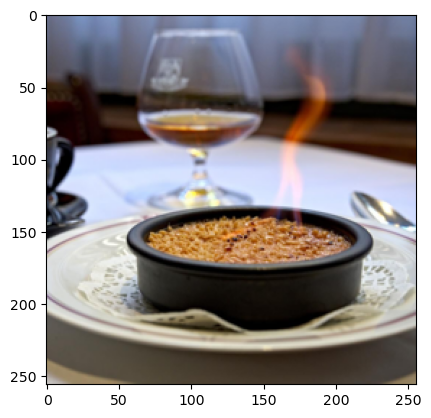

image 29 label:exterior


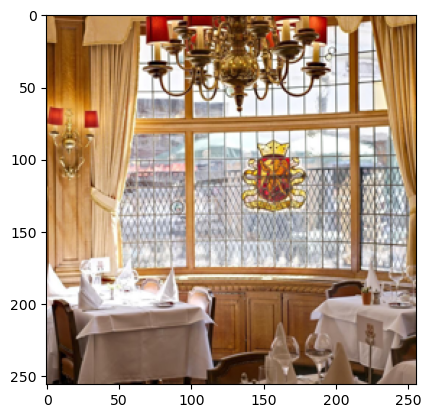

image 30 label:food


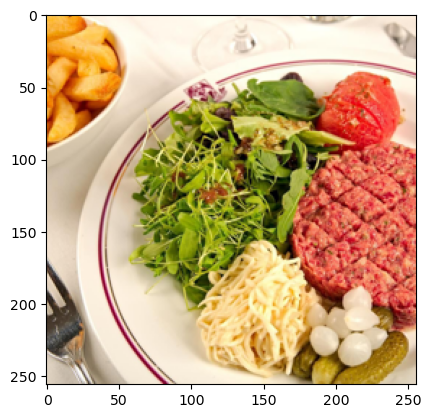

image 31 label:exterior


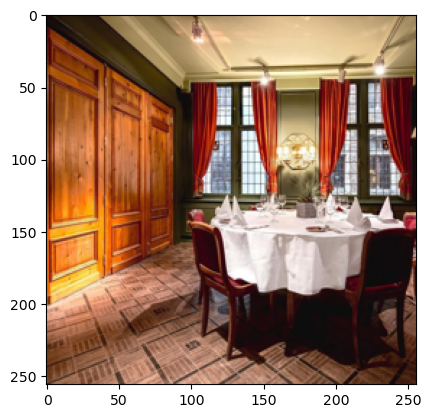

image 32 label:food


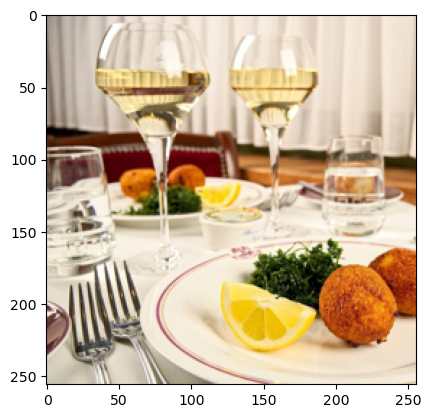

image 33 label:food


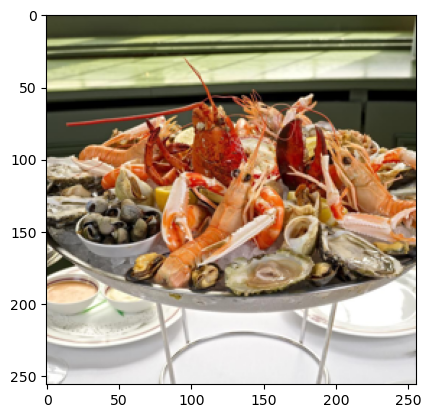

image 34 label:food


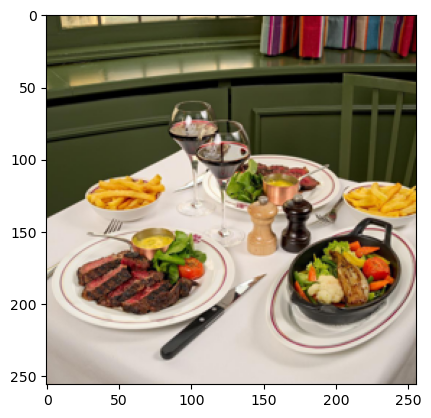

image 35 label:exterior


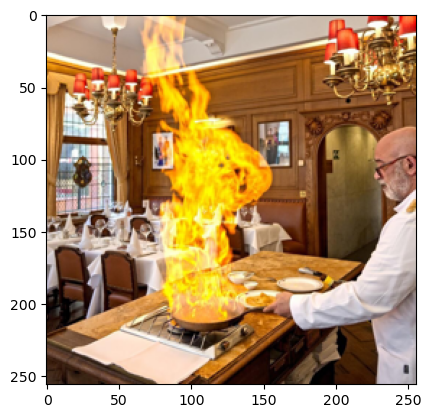

image 36 label:exterior


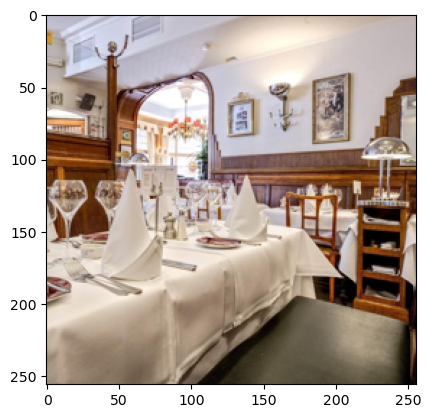

image 37 label:exterior


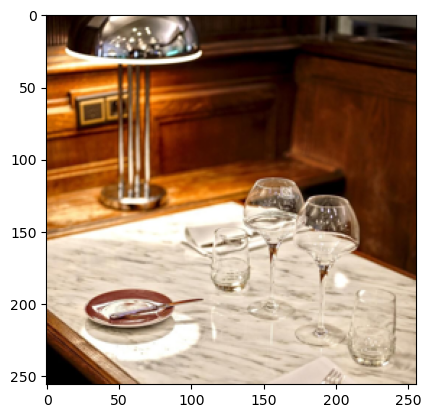

image 38 label:food


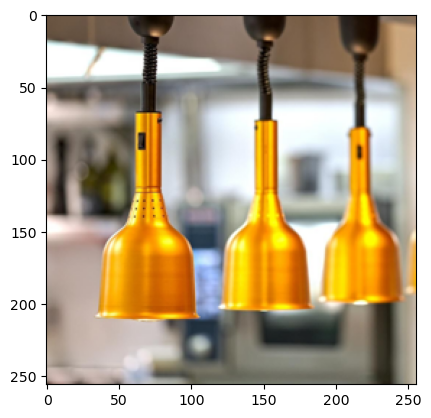

image 39 label:exterior


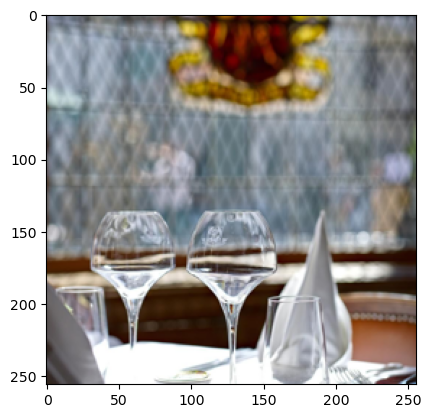

In [41]:
for ind, item in enumerate(new_images): # show images in order to check prediction 
    label=predicted_labels[ind][0]
    print('image ' + str(ind) + ' label:' + (label_dict[label]))
    plt.imshow(item, cmap='gray')
    plt.show()

In [ ]:
# def save_image(filename):
#     p = PdfPages(filename)
#     for ind, item in enumerate(new_images): # show images in order to check prediction 
#         label=predicted_labels[ind][0]
#         fig= plt.figure()
#         plt.imshow(item, cmap='gray')
#         plt.title('image ' + str(ind) + ' label:' + (label_dict[label]))
#         fig.savefig(p, format='pdf') 
#     # close the object
#     p.close()  

In [ ]:
# # name Pdf file
# filename = "multi_plot_image.pdf"  
# save_image(filename)  